<h1 align='center' style="color: blue;">INSY 5376 Deep Learning Project</h1>

In [ ]:
#!pip install kaggle
#!pip install librosa

In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets download -d andradaolteanu/gtzan-dataset-music-genre-classification

 99% 1.20G/1.21G [00:06<00:00, 126MB/s]
100% 1.21G/1.21G [00:06<00:00, 193MB/s]


In [ ]:
! unzip gtzan-dataset-music-genre-classification
!rm -r gtzan-dataset-music-genre-classification.zip

Archive:  gtzan-dataset-music-genre-classification.zip
  inflating: Data/features_30_sec.csv  
  inflating: Data/features_3_sec.csv  
  inflating: Data/genres_original/blues/blues.00000.wav  
  inflating: Data/genres_original/blues/blues.00001.wav  
  inflating: Data/genres_original/blues/blues.00002.wav  
  inflating: Data/genres_original/blues/blues.00003.wav  
  inflating: Data/genres_original/blues/blues.00004.wav  
  inflating: Data/genres_original/blues/blues.00005.wav  
  inflating: Data/genres_original/blues/blues.00006.wav  
  inflating: Data/genres_original/blues/blues.00007.wav  
  inflating: Data/genres_original/blues/blues.00008.wav  
  inflating: Data/genres_original/blues/blues.00009.wav  
  inflating: Data/genres_original/blues/blues.00010.wav  
  inflating: Data/genres_original/blues/blues.00011.wav  
  inflating: Data/genres_original/blues/blues.00012.wav  
  inflating: Data/genres_original/blues/blues.00013.wav  
  inflating: Data/genres_original/blues/blues.00014.wa

In [ ]:
#remove jazz0054.wav it is corrupt
!rm -r /content/Data/genres_original/jazz/jazz.00054.wav

rm: cannot remove '/content/Data/genres_original/jazz/jazz.00054.wav': No such file or directory


Matthew Mortensen<br>
UTA ID #1000550481

The goal of this project is to learn and really apply the concepts to a real world problem.  This project goes through music genre classification using the GTZAN dataset.

We will try many different machine learning algorithms and then try out a deep learning neural net and compare the accuracy of the models. If we can accurately classify music genres we can then use this model to create a music recomendation system.  Streaming platforms like Spotify and Pandora use music recommendation systems based on the same concepts but thier models are based on more complicated data.

## GTZAN Dataset

The GTZAN dataset is a collection of 10 genres with 100 audio files each, all having a length of 30 seconds (the famous GTZAN dataset, the MNIST of sounds). It also includes image files that are visual representations of each audio file. This is another way to classifiy data using neural networks. the audio files were converted to Mel Spectrograms to make this possible.


There are 2 CSV files - Containing features of the audio files. One file has for each song (30 seconds long) a mean and variance computed over multiple features that can be extracted from an audio file. The other file has the same structure, but the songs were split before into 3 seconds audio files (this way increasing 10 times the amount of data we fuel into our classification models). With data, more is always better.

We will start by installing any libraries needed and importing the moduels needed

In [ ]:
#!pip install librosa

In [ ]:
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from glob import glob # allows us to list all files to a directory
import IPython
import IPython.display as ipd # to play the Audio Files
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
import librosa # main package for working with Audio Data
import librosa.display


import os
import PIL
import PIL.Image
import tensorflow as tf

## Dealing with Audio Data

There are some basic concepts we should know if we are working with audio data; frequency, instensity(dB), and sample rate.

Frequency (Hz) when it comes to audio is defined as the rate at which a vibration occurs that constitutes a wave, either in a material (as in sound waves), or in an electromagnetic field (as in radio waves and light), usually measured per second.
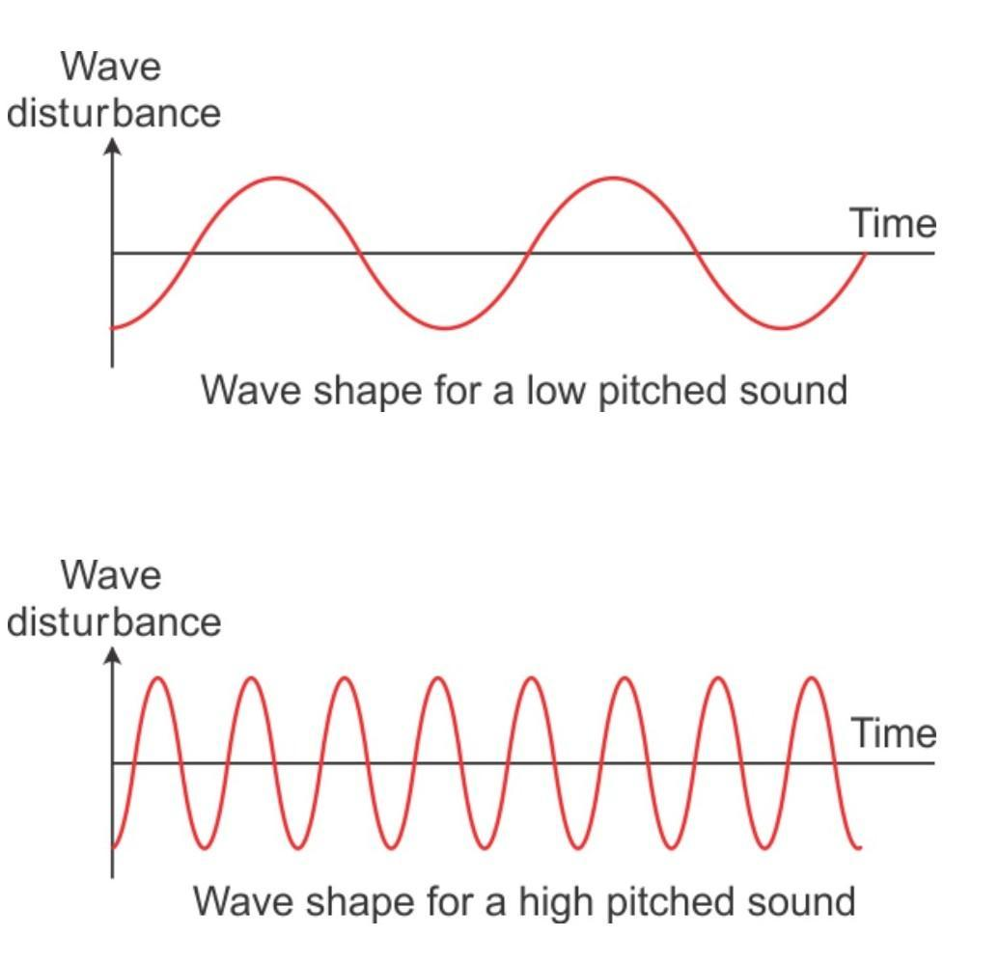

Intensity or deciebl (dB) is defined as a unit used to measure the intensity of a sound or the power level of an electrical signal by comparing it with a given level on a logarithmic scale.

The louder a sound is the more decibels it is. But as stated it is logarithimic in scale so if something is a difference of 1 db it is approximately 1.12 times as loud.

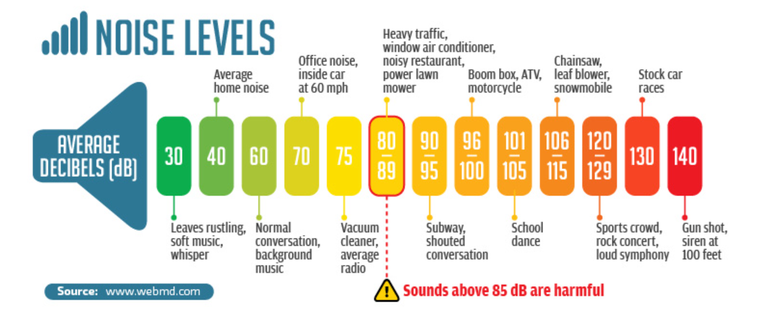

Sample rate is defined as the number of samples per second (or per other unit) taken from a continuous signal to make a discrete or digital signal.

Sample rate is how computers interpret audio signals and determine the quality of the audio signal.
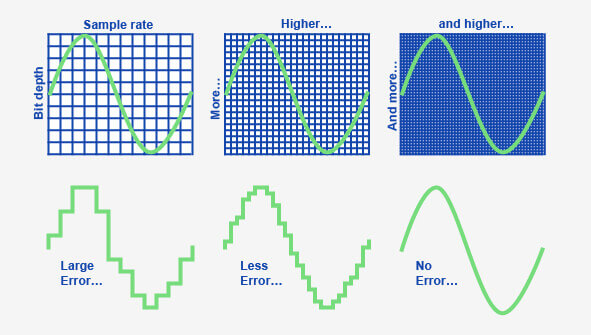

Let's see an example of how the sample music sounds

In [ ]:
audio_files = glob("/content/Data/genres_original/*/*.wav")

In [ ]:
ipd.Audio(audio_files[505])

## Loading Audio Files

We will use the package librosa to load the audio files into the program and also we can use other librosa functions to help create our recommender system.

In [ ]:
y, sr = librosa.load(audio_files[505]) #y is the audio file and sr is the sample rate of the file
print("Y is a numpy array:", y)
print("Shape of Y:", y.shape)
print("Sample Rate:", sr)

Y is a numpy array: [0.06167603 0.06103516 0.06005859 ... 0.05038452 0.06747437 0.05651855]
Shape of Y: (661504,)
Sample Rate: 22050


## Plot the file

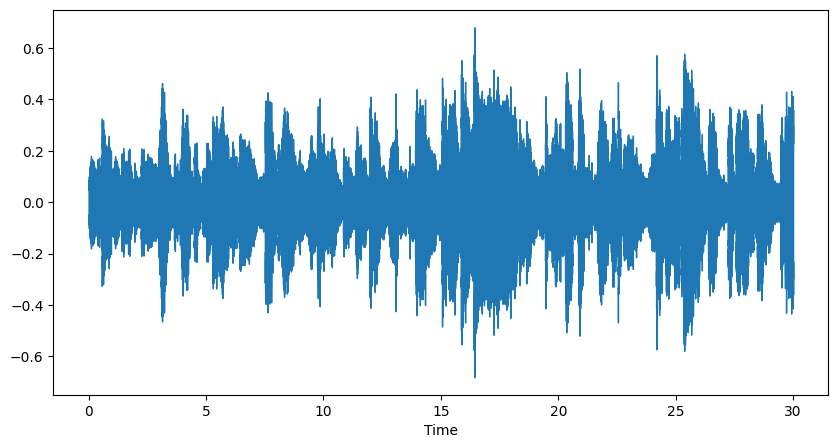

In [ ]:
plt.figure(figsize=(10,5))
librosa.display.waveshow(y)
plt.show()

## Processing the Audio for Spectrogram

So we have the audio frequency plotted but we want to look at how powerful (dB) those frequencies are.  To do this we will have to applay a Fourier transformation to the audio data.  To do this we can use librosa's stft() function.  After the transformation we can apply the decibels to the output.

In [ ]:
#Use STFT
FT = librosa.stft(y)
# convert from aplitude to decibel values
S_db = librosa.amplitude_to_db(np.abs(FT), ref=np.max)
#new data shape
print("New shape of transformed data", S_db.shape)

New shape of transformed data (1025, 1293)


## Spectrogram Plotting

Spectrograms are a visual representation of the spectrum of frequencies of a signal as it varies with time. When applied to an audio signal, spectrograms are sometimes called sonographs, voiceprints, or voicegrams.

It is a two-dimensional graph, with frequency on the vertical axis and time on the horizontal axis

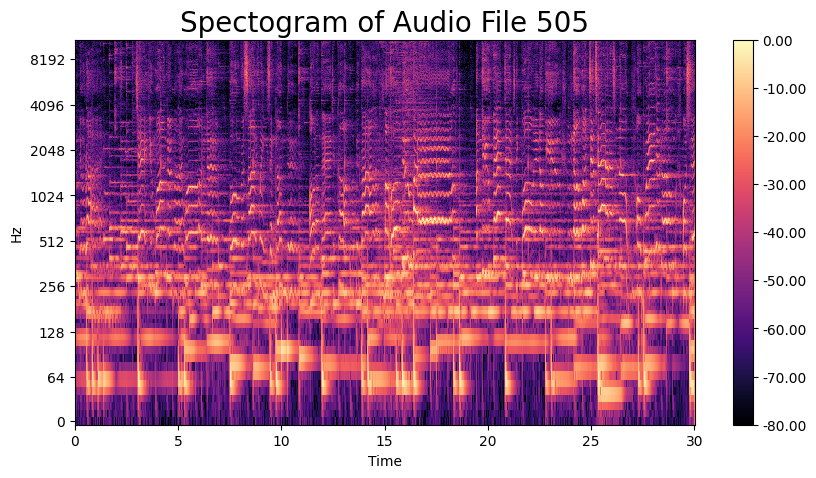

In [ ]:
# plot spectogram
fig, ax = plt.subplots(figsize=(10,5))
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax)
ax.set_title('Spectogram of Audio File 505', fontsize=20)
fig.colorbar(img, ax=ax, format=f'%0.2f');

## Mel Spectrograms

We do not perceive frequencies on a linear scale. We can easily detect differences in lower frequencies than higher frequencies. We can easily tell the difference between 500 and 1000 Hz, but we will hardly be able to tell a difference between 10,000 and 10,500 Hz, even though the distance between the two are the same. So in 1937 Stevens, Volkmann, and Newmann proposed a unit of pitch that equal distances in pitch sounded equally distant to the listener. This is called the mel scale. The Mel scale is a logarithmic scale that maps frequency to pitch in a way that is more closely related to how we perceive pitch.

A mel spectrogram is a spectrogram where the frequencies are converted to the mel scale.

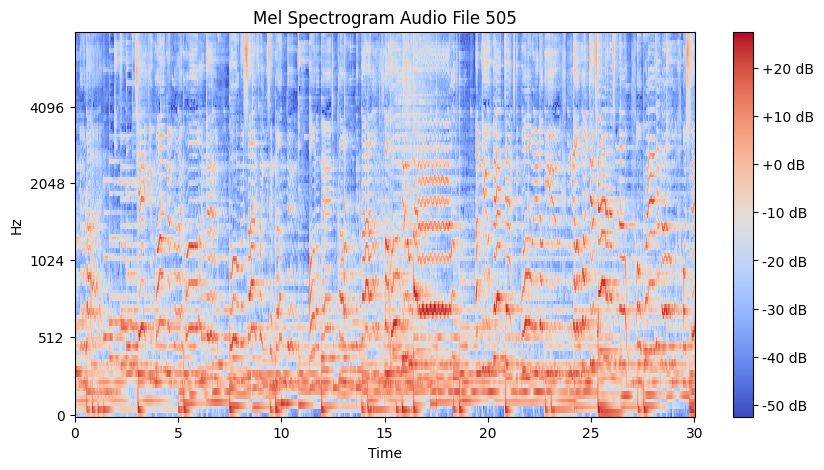

In [ ]:
plt.figure(figsize=(10, 5))
spectrogram = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,fmax=8000) 
spectrogram = librosa.power_to_db(spectrogram)
librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram Audio File 505')
plt.colorbar(format='%+2.0f dB');

Looks the mel spectrogram has cleared up a lot of noise compared to the normal spectrogram.  With this we can possibly use these images for deep learning.

## Chroma Vector

Chroma vectors are constructed by changing the full spectrum into 12 bins that represent the 12 notes (or Chroma) of music: C, C#, D, D#, E , F, F#, G, G#, A, A#, B. This could help us further differentiate between genres.

The chroma vectors can provide useful musical information about the audio and may even expose musical similarities in the same music genre that are not visible in the original spectra.

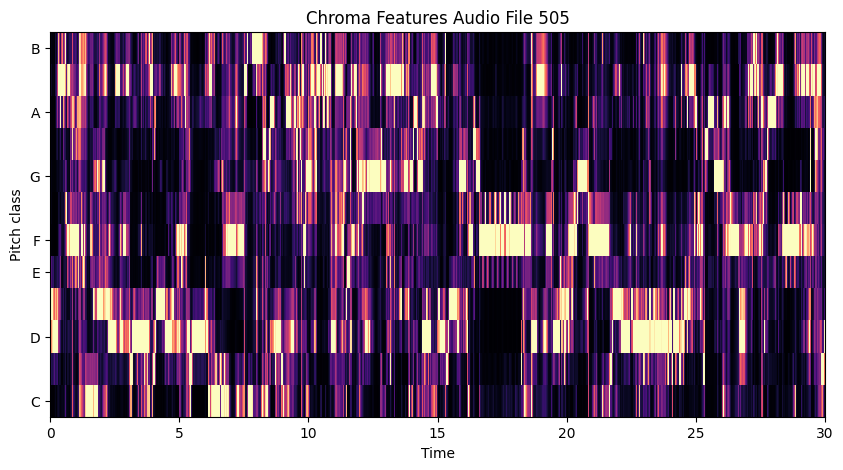

In [ ]:
plt.figure(figsize=(10, 5))
chroma = librosa.feature.chroma_stft(y=y, sr=sr)
librosa.display.specshow(chroma,sr=sr,x_axis="time",y_axis="chroma");
plt.title('Chroma Features Audio File 505')
plt.show()

All these features, including MFCC and tonal features are captured in the csv of the dataset.  Later on we will recreate these features to try and classify any music sent to our algorithm.

## CSV Data Analysis

We will use the csv that is broken down into 3 sec splits instead of 30 second splits. This gives us an oppotunity to have more data to pass to our algorithms.

In [ ]:
audio_df = pd.read_csv("/content/Data/features_3_sec.csv")
audio_df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [ ]:
audio_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9990 entries, 0 to 9989
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   filename                 9990 non-null   object 
 1   length                   9990 non-null   int64  
 2   chroma_stft_mean         9990 non-null   float64
 3   chroma_stft_var          9990 non-null   float64
 4   rms_mean                 9990 non-null   float64
 5   rms_var                  9990 non-null   float64
 6   spectral_centroid_mean   9990 non-null   float64
 7   spectral_centroid_var    9990 non-null   float64
 8   spectral_bandwidth_mean  9990 non-null   float64
 9   spectral_bandwidth_var   9990 non-null   float64
 10  rolloff_mean             9990 non-null   float64
 11  rolloff_var              9990 non-null   float64
 12  zero_crossing_rate_mean  9990 non-null   float64
 13  zero_crossing_rate_var   9990 non-null   float64
 14  harmony_mean            

Looks like we have 60 columns to work with.  One column of interest is tempo.  Different types of music have different beats per minute. Lets see if we can look at the tempo distrobution and gain any insight.

Text(0, 0.5, 'BPM')

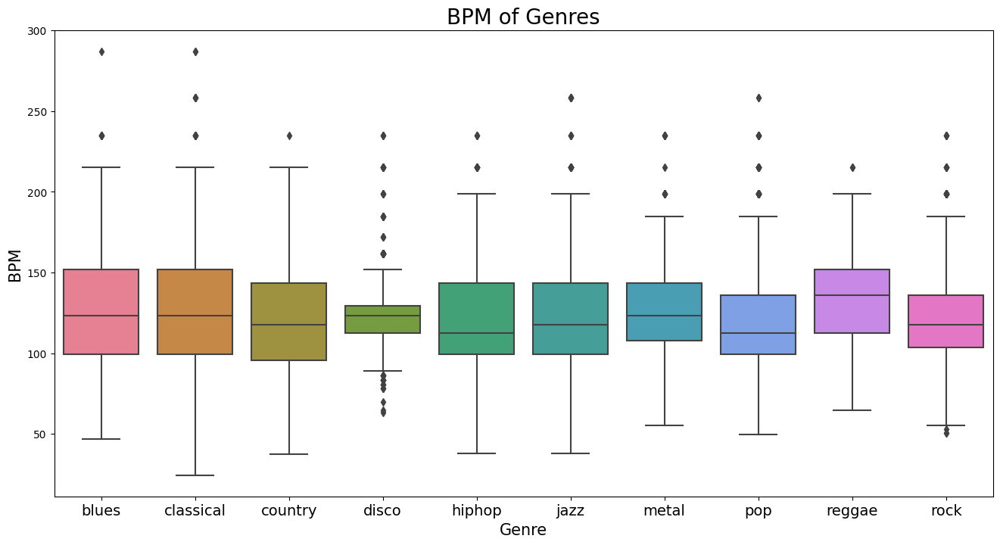

In [ ]:
x = audio_df[["label", "tempo"]]

fig, ax = plt.subplots(figsize=(16, 8));
sns.boxplot(x = "label", y = "tempo", data = x, palette = 'husl');

plt.title('BPM of Genres', fontsize = 20)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10);
plt.xlabel("Genre", fontsize = 15)
plt.ylabel("BPM", fontsize = 15)
#plt.savefig("BPM_Boxplot.png")

Well we can see some genres have a specific bpm range, like disco. Disco has a very small range compared to others.

## Data Preprocessing

We will have to do a little preprocessing to get everything ready for modeling.  We will have to drop the filename column and then encode the label column. Then we will scale the data using MinMaxScaler.

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
encoder = LabelEncoder()
scaler = MinMaxScaler()

In [ ]:
X = audio_df.drop(labels=["filename","label"],axis=1)
y = audio_df['label']

In [ ]:
X = scaler.fit_transform(X)
y = encoder.fit_transform(y)
X.shape, y.shape

((9990, 58), (9990,))

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=10)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((7992, 58), (1998, 58), (7992,), (1998,))

## KNN Model

KNN is widely used in machine learning and is normally used as a baseline when testing multiple models.  We will do the same and use KNN as our baseline

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

model_knn = KNeighborsClassifier(n_neighbors=3)
model_knn.fit(X_train, y_train)
y_hat_knn = model_knn.predict(X_test)
print("Training set score: {:.3f}".format(model_knn.score(X_train, y_train)))
print("Test set score: {:.3f}".format(model_knn.score(X_test, y_test)))
print('----------------------------------')
print("Classification Report - Logistic Regression")
print(classification_report(y_test,y_hat_knn))

Training set score: 0.963
Test set score: 0.918
----------------------------------
Classification Report - Logistic Regression
              precision    recall  f1-score   support

           0       0.90      0.96      0.93       210
           1       0.92      0.96      0.94       214
           2       0.87      0.90      0.88       200
           3       0.87      0.93      0.90       197
           4       0.94      0.95      0.94       202
           5       0.91      0.89      0.90       193
           6       0.99      0.96      0.97       208
           7       0.97      0.88      0.92       194
           8       0.92      0.92      0.92       178
           9       0.90      0.83      0.86       202

    accuracy                           0.92      1998
   macro avg       0.92      0.92      0.92      1998
weighted avg       0.92      0.92      0.92      1998



Not a bad start at all. 96% accuracy for training and 92% for testing.

Lets go through a couple of other models and then try out a CNN model

## SVM

Let's see how SVM will work. Since our data is nonliear SVM should give us a decent output.

In [ ]:
from sklearn.svm import SVC
svc = SVC(kernel='rbf', degree=8, random_state=10)
svc.fit(X_train, y_train)
print("Training set score: {:.3f}".format(svc.score(X_train, y_train)))
print("Test set score: {:.3f}".format(svc.score(X_test, y_test)))
print('----------------------------------')
print("Classification Report - Logistic Regression")
y_hat_svc = svc.predict(X_test)
print(classification_report(y_test, y_hat_svc))

Training set score: 0.775
Test set score: 0.745
----------------------------------
Classification Report - Logistic Regression
              precision    recall  f1-score   support

           0       0.71      0.80      0.76       210
           1       0.89      0.92      0.90       214
           2       0.67      0.67      0.67       200
           3       0.65      0.71      0.68       197
           4       0.78      0.67      0.72       202
           5       0.78      0.81      0.79       193
           6       0.82      0.88      0.85       208
           7       0.85      0.81      0.83       194
           8       0.66      0.72      0.69       178
           9       0.59      0.45      0.51       202

    accuracy                           0.75      1998
   macro avg       0.74      0.74      0.74      1998
weighted avg       0.74      0.75      0.74      1998



Well it is definitely worse than our KNN model. Next lets look at a random forrest model

## Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
model_RF = RandomForestClassifier(random_state=10)
model_RF.fit(X_train, y_train)
y_hat_RF = model_RF.predict(X_test)
print("Training set score: {:.3f}".format(model_RF.score(X_train, y_train)))
print("Test set score: {:.3f}".format(model_RF.score(X_test, y_test)))
print('----------------------------------')
print("Classification Report - Logistic Regression")
print(classification_report(y_test,y_hat_RF))

Training set score: 0.999
Test set score: 0.880
----------------------------------
Classification Report - Logistic Regression
              precision    recall  f1-score   support

           0       0.90      0.92      0.91       210
           1       0.91      0.97      0.94       214
           2       0.81      0.83      0.82       200
           3       0.84      0.90      0.87       197
           4       0.92      0.85      0.88       202
           5       0.87      0.88      0.88       193
           6       0.90      0.96      0.93       208
           7       0.91      0.88      0.89       194
           8       0.84      0.90      0.87       178
           9       0.88      0.70      0.78       202

    accuracy                           0.88      1998
   macro avg       0.88      0.88      0.88      1998
weighted avg       0.88      0.88      0.88      1998



Again, not as good as our knn algorithm.  Now lets see what happens when we create a CNN model.

## CNN

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
model_CNN = tf.keras.models.Sequential([
    tf.keras.layers.Dense(1024, activation="relu", input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(512,activation="relu"),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(256,activation="relu"),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(128,activation="relu"),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(64,activation="relu"),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(10, activation="softmax"), #ten categories
    
])

In [ ]:
print(model_CNN.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 1024)              60416     
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 dense_1 (Dense)             (None, 512)               524800    
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 256)               131328    
                                                                 
 dropout_2 (Dropout)         (None, 256)               0         
                                                                 
 dense_3 (Dense)             (None, 128)               3

In [ ]:
model_CNN.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics='accuracy')

In [ ]:
history = model_CNN.fit(X_train, y_train, 
                        validation_data=(X_test, y_test), 
                        epochs=300, 
                        batch_size=128)

Epoch 1/300
63/63 [==============================] - 8s 11ms/step - loss: 1.9645 - accuracy: 0.2710 - val_loss: 1.5606 - val_accuracy: 0.4194
Epoch 2/300
63/63 [==============================] - 0s 7ms/step - loss: 1.5116 - accuracy: 0.4381 - val_loss: 1.3099 - val_accuracy: 0.5360
Epoch 3/300
63/63 [==============================] - 0s 7ms/step - loss: 1.3332 - accuracy: 0.5130 - val_loss: 1.1569 - val_accuracy: 0.5791
Epoch 4/300
63/63 [==============================] - 0s 6ms/step - loss: 1.2246 - accuracy: 0.5549 - val_loss: 1.1028 - val_accuracy: 0.5846
Epoch 5/300
63/63 [==============================] - 0s 5ms/step - loss: 1.1180 - accuracy: 0.6004 - val_loss: 0.9794 - val_accuracy: 0.6421
Epoch 6/300
63/63 [==============================] - 0s 5ms/step - loss: 1.0522 - accuracy: 0.6305 - val_loss: 0.9797 - val_accuracy: 0.6476
Epoch 7/300
63/63 [==============================] - 0s 5ms/step - loss: 1.0179 - accuracy: 0.6446 - val_loss: 0.9320 - val_accuracy: 0.6722
Epoch 8/300


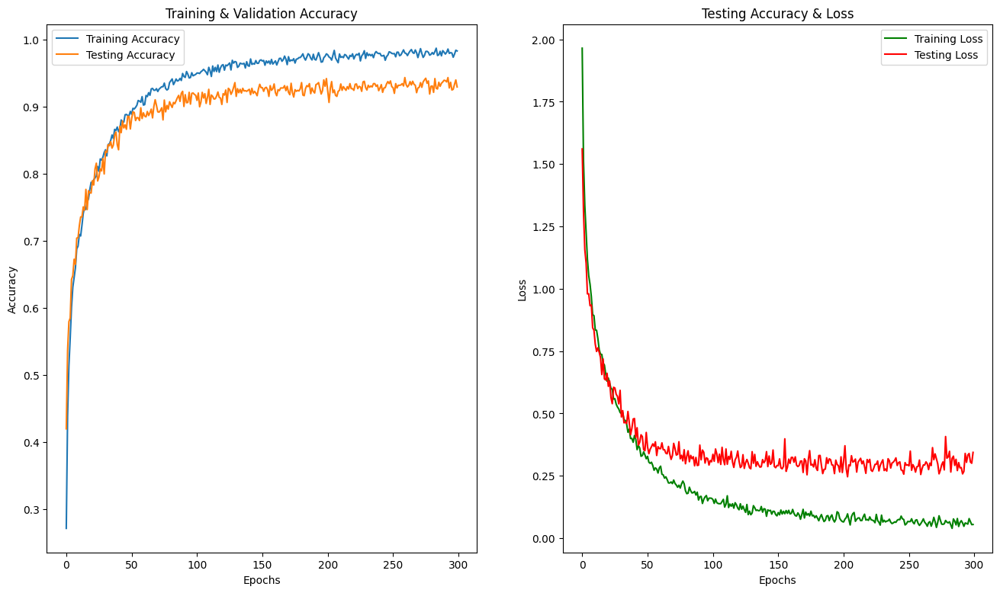

In [ ]:
epochs = [i for i in range(300)]
fig , ax = plt.subplots(1,2)
train_acc = history.history['accuracy']
train_loss = history.history['loss']
val_acc = history.history['val_accuracy']
val_loss = history.history['val_loss']
fig.set_size_inches(16,9)

ax[0].plot(epochs , train_acc, label = 'Training Accuracy')
ax[0].plot(epochs , val_acc, label = 'Testing Accuracy')
ax[0].set_title('Training & Validation Accuracy')
ax[0].legend()
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")

ax[1].plot(epochs , train_loss , 'g' , label = 'Training Loss')
ax[1].plot(epochs , val_loss , 'r' , label = 'Testing Loss')
ax[1].set_title('Testing Accuracy & Loss')
ax[1].legend()
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Loss")
plt.show()

In [ ]:
test_loss, test_acc  = model_CNN.evaluate(X_test, y_test, batch_size=128)
print("The test Loss is :",test_loss)
print("The Best test Accuracy is :",test_acc*100)

16/16 [==============================] - 0s 3ms/step - loss: 0.3440 - accuracy: 0.9289
The test Loss is : 0.34398213028907776
The Best test Accuracy is : 92.89289116859436


So as it stands right now our CNN model marginally beats our KNN model. Maybe with some adjustments to our CNN model we can fine tune it to be better but as it stands right now the difference between CNN and KNN are very slim.

## Music Recomendation

Music recomendation systems have been around for a while now. Streaming services like Spotify, Pandora, YouTube, etc., use recomender systems to suggest songs or content that you may be interested in.  But sometimes these recommender systems give very strange recomendations.  Take for example Spotify.  You listen to a few songs and then it recommends a song that is completely different than what you have been listening to. How did that song get recommended?  To find out, let's go over some basics for recommender systems.

Recomender Systems are normally broken down into 2 categories, Collaborative filtering and Content-based.

#### Collaborative filtering
Collaborative filtering is normally centered around looking at particular user's tastes and then recomending items/songs based on that analyis. So for example user 1 likes to song 1 and song 2 and user 2 likes song 1, song 2, and song 3 the system may recommend song 3 to user 1 since they seem to have similar tastes.  This could be great for popular songs but when it comes to not so popular songs they may never be recommended due to not enough people listening for a user comparison.

#### Content-based
content-based filtering differs than collaborative filtering since it recomends content based on the item itself and the user.  Content-based explores the features of the item or song to determine what features are most important to users. Then based on the song features and user preferences it will recommend a song.

As it stands right now we are going to use content-based filtering. We have analyized components and then classified them into genres. We can make a simple music recommender system based on the similarites of a given song. But how do we choose those similarites?

#### Cosine similarity
Cosine similarity measures the similarity between two vectors of an inner product space. It is measured by the cosine of the angle between two vectors and determines whether two vectors are pointing in roughly the same direction. So the smaller the angle between the two vectors the closer they are to each other. The image below represents cosine similarity well.

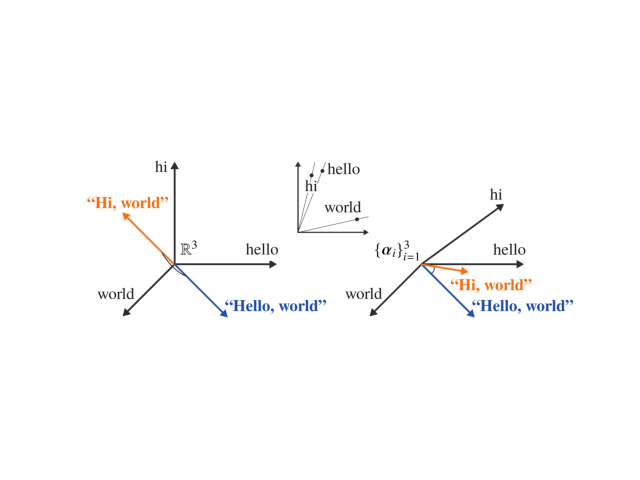

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
from sklearn import preprocessing

# Read data
data = pd.read_csv("/content/Data/features_30_sec.csv", index_col='filename')

# Extract labels
labels = data[['label']]

# Drop labels from original dataframe
data = data.drop(columns=['length','label'])

# Scale the data
data_scaled=preprocessing.scale(data)
print('Scaled data type:', type(data_scaled))

Scaled data type: <class 'numpy.ndarray'>


In [ ]:
# Cosine similarity
similarity = cosine_similarity(data_scaled)

# Convert into a dataframe and then set the row index and column names as labels
sim_df_labels = pd.DataFrame(similarity)
sim_df_names = sim_df_labels.set_index(labels.index)
sim_df_names.columns = labels.index

sim_df_names.head()

filename,blues.00000.wav,blues.00001.wav,blues.00002.wav,blues.00003.wav,blues.00004.wav,blues.00005.wav,blues.00006.wav,blues.00007.wav,blues.00008.wav,blues.00009.wav,...,rock.00090.wav,rock.00091.wav,rock.00092.wav,rock.00093.wav,rock.00094.wav,rock.00095.wav,rock.00096.wav,rock.00097.wav,rock.00098.wav,rock.00099.wav
filename,,,,,,,,,,,,,,,,,,,,,
blues.00000.wav,1.000000,0.049231,0.589618,0.284862,0.025561,-0.346688,-0.219483,-0.167626,0.641877,-0.097889,...,-0.082829,0.546169,0.578558,0.662590,0.571629,0.610942,0.640835,0.496294,0.284958,0.304098
blues.00001.wav,0.049231,1.000000,-0.096834,0.520903,0.080749,0.307856,0.318286,0.415258,0.120649,0.404168,...,-0.098111,-0.325126,-0.370792,-0.191698,-0.330834,-0.077301,-0.222119,-0.302573,0.499562,0.311723
blues.00002.wav,0.589618,-0.096834,1.000000,0.210411,0.400266,-0.082019,-0.028061,0.104446,0.468113,-0.132532,...,-0.032408,0.561074,0.590779,0.583293,0.514537,0.495707,0.566837,0.589983,0.216378,0.321069
blues.00003.wav,0.284862,0.520903,0.210411,1.000000,0.126437,0.134796,0.300746,0.324566,0.352758,0.295184,...,-0.320107,-0.206516,-0.151132,0.041986,-0.172515,-0.000287,0.020515,-0.107821,0.502279,0.183210
blues.00004.wav,0.025561,0.080749,0.400266,0.126437,1.000000,0.556066,0.482195,0.623455,0.029703,0.471657,...,0.087605,0.017366,0.138035,0.104684,-0.034594,0.063454,0.063546,0.172944,0.153192,0.061785


In [ ]:
def find_similar_songs(name):
    # Find songs most similar to another song
    series = sim_df_names[name].sort_values(ascending = False)
    
    # Remove cosine similarity == 1 (songs will always have the best match with themselves)
    series = series.drop(name)
    
    # Display the 5 top matches 
    print("\n*******\nSimilar songs to ", name)
    print(series.head(5))

In [ ]:
find_similar_songs('rock.00026.wav') 

ipd.Audio("/content/Data/genres_original/rock/rock.00026.wav")


*******
Similar songs to  rock.00026.wav
filename
rock.00017.wav    0.942684
rock.00087.wav    0.935204
rock.00025.wav    0.914531
rock.00020.wav    0.910803
rock.00018.wav    0.910113
Name: rock.00026.wav, dtype: float64


In [ ]:
ipd.Audio("/content/Data/genres_original/rock/rock.00017.wav")

## Recreating the dataset features and Testing with Online Music

We have already discussed many topics. Now lets combine them and see if we can put it all together and try and classify genres from music outside the dataset.  Below we will extra the mel spectrogram, MFCC, Chroma Vector, and tonal features and see how our classification does.

In [ ]:
def get_mfcc(wav_file_path):
    y, sr = librosa.load(wav_file_path, offset=0, duration=30)
    mfcc = np.array(librosa.feature.mfcc(y=y, sr=sr))
    return mfcc

In [ ]:
def get_melspect(wav_file_path):
    y, sr = librosa.load(wav_file_path, offset=0, duration=30)
    melspect = np.array(librosa.feature.melspectrogram(y=y, sr=sr))
    return melspect

In [ ]:
def get_chroma_vector(wav_file_path):
    y, sr = librosa.load(wav_file_path)
    chroma = np.array(librosa.feature.chroma_stft(y=y, sr=sr))
    return chroma

In [ ]:
def get_tonnetz(wav_file_path):
    y, sr = librosa.load(wav_file_path)
    tonnetz = np.array(librosa.feature.tonnetz(y=y, sr=sr))
    return tonnetz

In [ ]:
def get_feature(file_path):
    # Extracting MFCC feature
    mfcc = get_mfcc(file_path)
    mfcc_mean = mfcc.mean(axis=1)
    mfcc_min = mfcc.min(axis=1)
    mfcc_max = mfcc.max(axis=1)
    mfcc_feature = np.concatenate((mfcc_mean, mfcc_min, mfcc_max))
    
    # Extracting Mel Spectrogram feature
    melspect = get_melspect(file_path)
    melspect_mean = melspect.mean(axis=1)
    melspect_min = melspect.min(axis=1)
    melspect_max = melspect.max(axis=1)
    melspect_feature = np.concatenate((melspect_mean, melspect_min, melspect_max))
    
    # Extracting chroma vector feature
    chroma = get_chroma_vector(file_path)
    chroma_mean = chroma.mean(axis=1)
    chroma_min = chroma.min(axis=1)
    chroma_max = chroma.max(axis=1)
    chroma_feature = np.concatenate((chroma_mean, chroma_min, chroma_max))
                                       
    # Extracting tonnetz feature
    tonnetz = get_tonnetz(file_path)
    tonnetz_mean = tonnetz.mean(axis=1)
    tonnetz_min = tonnetz.min(axis=1)
    tonnetz_max = tonnetz.max(axis=1)
    tonnetz_feature = np.concatenate((tonnetz_mean, tonnetz_min, tonnetz_max))
    feature = np.concatenate((chroma_feature, melspect_feature, mfcc_feature, tonnetz_feature))
    return feature

The above functions will get features that are similar to the csv of GTZAN but not as robust. This can easily be improved based on adding more features than what we have gathered.

Now lets see if we can create a CNN that can predict genre's from music from outside the datset. To test this out we will just use 3 categories.  It will be easier for our CNN to get a reliable output.

In [ ]:
directory = "/content/Data/genres_original"
genres = ['reggae','classical','rock']
features = []
labels = []
for genre in genres:
    print("Calculating features for genre : " + genre)
    for file in os.listdir(directory+"/"+genre):
        file_path = directory+"/"+genre+"/"+file

        features.append(get_feature(file_path))
        label = genres.index(genre)
        labels.append(label)

Calculating features for genre : reggae
Calculating features for genre : classical
Calculating features for genre : rock


Lets suffle the list and then do our training and testing splits.

In [ ]:
permutations = np.random.permutation(300)
features = np.array(features)[permutations]
labels = np.array(labels)[permutations]
X1_train, X1_test, y1_train, y1_test = train_test_split(features, labels, test_size=0.2, random_state=10)
X1_train.shape, X1_test.shape, y1_train.shape, y1_test.shape

((240, 498), (60, 498), (240,), (60,))

In [ ]:
inputs = tf.keras.Input(shape=(498), name="feature")
x = tf.keras.layers.Dense(512, activation="relu", name="dense_1")(inputs)
x = tf.keras.layers.Dense(256, activation="relu", name="dense_2")(x)
x = tf.keras.layers.Dense(128, activation="relu", name="dense_3")(x)
x = tf.keras.layers.Dense(64, activation="relu", name="dense_4")(x)
outputs = tf.keras.layers.Dense(3, activation="softmax", name="predictions")(x)

model = tf.keras.Model(inputs=inputs, outputs=outputs)

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics='accuracy')


model.fit(x=X1_train.tolist(),y=y1_train.tolist(),verbose=1,
           validation_data=(X1_test.tolist() , y1_test.tolist()),
           epochs=100)

Epoch 1/100
8/8 [==============================] - 2s 87ms/step - loss: 12.1797 - accuracy: 0.6708 - val_loss: 12.1970 - val_accuracy: 0.7167
Epoch 2/100
8/8 [==============================] - 0s 11ms/step - loss: 10.0210 - accuracy: 0.7417 - val_loss: 18.1315 - val_accuracy: 0.6333
Epoch 3/100
8/8 [==============================] - 0s 12ms/step - loss: 9.0243 - accuracy: 0.7333 - val_loss: 15.6748 - val_accuracy: 0.6167
Epoch 4/100
8/8 [==============================] - 0s 13ms/step - loss: 4.1733 - accuracy: 0.8042 - val_loss: 8.0263 - val_accuracy: 0.7667
Epoch 5/100
8/8 [==============================] - 0s 10ms/step - loss: 1.3013 - accuracy: 0.9083 - val_loss: 4.1201 - val_accuracy: 0.8500
Epoch 6/100
8/8 [==============================] - 0s 9ms/step - loss: 0.1456 - accuracy: 0.9708 - val_loss: 4.6671 - val_accuracy: 0.7667
Epoch 7/100
8/8 [==============================] - 0s 10ms/step - loss: 0.1499 - accuracy: 0.9625 - val_loss: 4.8964 - val_accuracy: 0.7500
Epoch 8/100
8/8 

In [ ]:
score = model.evaluate(x=X1_test.tolist(),y=y1_test.tolist(), verbose=0)
print('Accuracy : ' + str(score[1]*100) + '%')

Accuracy : 80.0000011920929%


So we have a model created and it has decent accuracy. Let's try and load some files from the internet and see if they can predict the genre

In [ ]:
!pip install yt_dlp
!pip install pydub
!pip install ffmpeg
# from anaconda console ->conda install -c conda-forge ffmpeg

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 34.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.9/129.9 kB 17.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 86.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 86.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.6/193.6 kB 25.5 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for ffmpeg: filename=ffmpeg-1.4-py3-none-any.whl size=6083 sha256=afa58acbe83657d5ef9eecab536ca4e20c0b2e6c83d2ef2e45a4c63fd4152ca0
  Stored in directory: /root/.cache/pip/wheels/8e/7a/69/cd6aeb83b126a7f04cbe7c9d929028dc52a6e7d525ff56003a
Successfu

In [ ]:
import yt_dlp
import os

def download_audio(link):
    with yt_dlp.YoutubeDL({'extract_audio': True, 'format': 'bestaudio', 'outtmpl': '%(title)s.mp3'}) as video:
        info_dict = video.extract_info(link, download = True)
        video_title = info_dict['title']
        file_name = video_title +'.mp3'
        print(video_title)
        video.download(link)
        print("Successfully Downloaded - see local folder on Google Colab")
        return file_name

title1 = download_audio('https://www.youtube.com/watch?v=_qRN8HoZtbo')

[youtube] Extracting URL: https://www.youtube.com/watch?v=_qRN8HoZtbo
[youtube] _qRN8HoZtbo: Downloading webpage
[youtube] _qRN8HoZtbo: Downloading android player API JSON
[info] _qRN8HoZtbo: Downloading 1 format(s): 251
[dashsegments] Total fragments: 1
[download] Destination: Bob Marley - Jamming.mp3
[download] 100% of    3.66MiB in 00:00:00 at 17.88MiB/s              
Bob Marley - Jamming
[youtube] Extracting URL: https://www.youtube.com/watch?v=_qRN8HoZtbo
[youtube] _qRN8HoZtbo: Downloading webpage
[youtube] _qRN8HoZtbo: Downloading android player API JSON
[info] _qRN8HoZtbo: Downloading 1 format(s): 251
[download] Bob Marley - Jamming.mp3 has already been downloaded
[download] 100% of    3.66MiB
Successfully Downloaded - see local folder on Google Colab


Now that we have downloaded the audio we need to cut it into a 30 second slice. We will start our audio segment at 1 mintue to 1:30.

In [ ]:
from pydub import AudioSegment
t1 = 60000 #starting at 1:00 min in miliseconds
t2 = 90000
waveFile = AudioSegment.from_file(title1)
waveFile = waveFile[t1:t2]
waveFile.export('audio_sample_30s.wav', format="wav")

<_io.BufferedRandom name='audio_sample_30s.wav'>

In [ ]:
ipd.Audio("/content/Bob Marley - Jamming.mp3")

In [ ]:
file_path = "audio_sample_30s.wav"
feature = get_feature(file_path)
y = model.predict(feature.reshape(1,498))
ind = np.argmax(y)
genres[ind]

1/1 [==============================] - 0s 108ms/step


'reggae'

In [ ]:
title2 = download_audio('https://www.youtube.com/watch?v=MgFhNbFvl_s')

[youtube] Extracting URL: https://www.youtube.com/watch?v=MgFhNbFvl_s
[youtube] MgFhNbFvl_s: Downloading webpage
[youtube] MgFhNbFvl_s: Downloading android player API JSON
[info] MgFhNbFvl_s: Downloading 1 format(s): 251
[dashsegments] Total fragments: 1
[download] Destination: Beethoven - Fur Elise.mp3
[download] 100% of    4.07MiB in 00:00:00 at 24.93MiB/s              
Beethoven - Fur Elise
[youtube] Extracting URL: https://www.youtube.com/watch?v=MgFhNbFvl_s
[youtube] MgFhNbFvl_s: Downloading webpage
[youtube] MgFhNbFvl_s: Downloading android player API JSON
[info] MgFhNbFvl_s: Downloading 1 format(s): 251
[download] Beethoven - Fur Elise.mp3 has already been downloaded
[download] 100% of    4.07MiB
Successfully Downloaded - see local folder on Google Colab


In [ ]:
from pydub import AudioSegment
t1 = 60000 #starting at 1:00 min in miliseconds
t2 = 90000
waveFile = AudioSegment.from_file(title2)
waveFile = waveFile[t1:t2]
waveFile.export('audio_sample_30s.wav', format="wav")

<_io.BufferedRandom name='audio_sample_30s.wav'>

In [ ]:
ipd.Audio("/content/Beethoven - Fur Elise.mp3")

In [ ]:
file_path = "audio_sample_30s.wav"
feature = get_feature(file_path)
y = model.predict(feature.reshape(1,498))
ind = np.argmax(y)
genres[ind]

1/1 [==============================] - 0s 77ms/step


'classical'

In [ ]:
title3 = download_audio('https://www.youtube.com/watch?v=1k8craCGpgs')

[youtube] Extracting URL: https://www.youtube.com/watch?v=1k8craCGpgs
[youtube] 1k8craCGpgs: Downloading webpage
[youtube] 1k8craCGpgs: Downloading android player API JSON
[info] 1k8craCGpgs: Downloading 1 format(s): 251
[dashsegments] Total fragments: 1
[download] Destination: Journey - Don't Stop Believin' (Official Audio).mp3
[download] 100% of    3.88MiB in 00:00:00 at 21.90MiB/s              
Journey - Don't Stop Believin' (Official Audio)
[youtube] Extracting URL: https://www.youtube.com/watch?v=1k8craCGpgs
[youtube] 1k8craCGpgs: Downloading webpage
[youtube] 1k8craCGpgs: Downloading android player API JSON
[info] 1k8craCGpgs: Downloading 1 format(s): 251
[download] Journey - Don't Stop Believin' (Official Audio).mp3 has already been downloaded
[download] 100% of    3.88MiB
Successfully Downloaded - see local folder on Google Colab


In [ ]:
from pydub import AudioSegment
t1 = 60000 #starting at 1:00 min in miliseconds
t2 = 90000
waveFile = AudioSegment.from_file(title3)
waveFile = waveFile[t1:t2]
waveFile.export('audio_sample_30s.wav', format="wav")

<_io.BufferedRandom name='audio_sample_30s.wav'>

In [ ]:
ipd.Audio("/content/Journey - Don't Stop Believin' (Official Audio).mp3")

In [ ]:
file_path = "audio_sample_30s.wav"
feature = get_feature(file_path)
y = model.predict(feature.reshape(1,498))
ind = np.argmax(y)
genres[ind]

1/1 [==============================] - 0s 47ms/step


'rock'

OK so the concept is solid. What happens if we try the entire dataset? How does the genre classification do with more data?

In [ ]:
directory = "/content/Data/genres_original"
genres = ['blues','classical','country','disco','hiphop','jazz','metal','pop','reggae','rock']
features_full = []
labels_full = []
for genre in genres:
    print("Calculating features for genre : " + genre)
    for file in os.listdir(directory+"/"+genre):
        file_path = directory+"/"+genre+"/"+file

        features_full.append(get_feature(file_path))
        label = genres.index(genre)
        labels_full.append(label)

Calculating features for genre : blues
Calculating features for genre : classical
Calculating features for genre : country
Calculating features for genre : disco
Calculating features for genre : hiphop
Calculating features for genre : jazz
Calculating features for genre : metal
Calculating features for genre : pop
Calculating features for genre : reggae
Calculating features for genre : rock


Again lets shuffle the list and then create our training and testing splits.

In [ ]:
permutations = np.random.permutation(999)
features_full = np.array(features_full)[permutations]
labels_full = np.array(labels_full)[permutations]
X2_train, X2_test, y2_train, y2_test = train_test_split(features_full, labels_full, test_size=0.2, random_state=10)
X2_train.shape, X2_test.shape, y2_train.shape, y2_test.shape

((799, 498), (200, 498), (799,), (200,))

In [ ]:
inputs = tf.keras.Input(shape=(498), name="feature")
x = tf.keras.layers.Dense(512, activation="relu", name="dense_1")(inputs)
x = tf.keras.layers.Dense(256, activation="relu", name="dense_2")(x)
x = tf.keras.layers.Dense(128, activation="relu", name="dense_3")(x)
x = tf.keras.layers.Dense(64, activation="relu", name="dense_4")(x)
outputs = tf.keras.layers.Dense(10, activation="softmax", name="predictions")(x)

model_full = tf.keras.Model(inputs=inputs, outputs=outputs)

model_full.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics='accuracy')


model_full.fit(x=X2_train.tolist(),y=y2_train.tolist(),verbose=1,
           validation_data=(X2_test.tolist() , y2_test.tolist()),
           epochs=30)

Epoch 1/30
25/25 [==============================] - 2s 23ms/step - loss: 31.2049 - accuracy: 0.2378 - val_loss: 10.0519 - val_accuracy: 0.3100
Epoch 2/30
25/25 [==============================] - 0s 5ms/step - loss: 7.7914 - accuracy: 0.3392 - val_loss: 6.0949 - val_accuracy: 0.3350
Epoch 3/30
25/25 [==============================] - 0s 6ms/step - loss: 4.2313 - accuracy: 0.4481 - val_loss: 4.2626 - val_accuracy: 0.4200
Epoch 4/30
25/25 [==============================] - 0s 5ms/step - loss: 2.5008 - accuracy: 0.5469 - val_loss: 4.1354 - val_accuracy: 0.3950
Epoch 5/30
25/25 [==============================] - 0s 5ms/step - loss: 1.9948 - accuracy: 0.5995 - val_loss: 4.0155 - val_accuracy: 0.3800
Epoch 6/30
25/25 [==============================] - 0s 5ms/step - loss: 1.4322 - accuracy: 0.6859 - val_loss: 3.9110 - val_accuracy: 0.4550
Epoch 7/30
25/25 [==============================] - 0s 6ms/step - loss: 1.1631 - accuracy: 0.7059 - val_loss: 3.0819 - val_accuracy: 0.4600
Epoch 8/30
25/25 

In [ ]:
score = model_full.evaluate(x=X2_test.tolist(),y=y2_test.tolist(), verbose=0)
print('Accuracy : ' + str(score[1]*100) + '%')

Accuracy : 53.50000262260437%


In [ ]:
file_path = "audio_sample_30s.wav"
feature = get_feature(file_path)
y = model_full.predict(feature.reshape(1,498))
ind = np.argmax(y)
genres[ind]

1/1 [==============================] - 0s 123ms/step


'country'

In [ ]:
'''
title4 = download_audio('tbd')
from pydub import AudioSegment
t1 = 60000 #starting at 1:00 min in miliseconds
t2 = 90000
waveFile = AudioSegment.from_file(title4)
waveFile = waveFile[t1:t2]
waveFile.export('audio_sample_30s.wav', format="wav")
'''

'\ntitle4 = download_audio(\'tbd\')\nfrom pydub import AudioSegment\nt1 = 60000 #starting at 1:00 min in miliseconds\nt2 = 90000\nwaveFile = AudioSegment.from_file(title4)\nwaveFile = waveFile[t1:t2]\nwaveFile.export(\'audio_sample_30s.wav\', format="wav")\n'

Well it looks like we need some tweaking to try and get the nueral net to be better than around 60%.  We could possibly cut the spectrum up into 3s intervals like we did above or try and extract more audio features. But it is a good start

## Using Mel Spectorgram for CNN

Included in the dataset are images of the Mel Spectrogram for each song for use in creating CNN models.  We will try this out and see what we can get from a faily simple CNN model.

Need to create a dataset from the images. Following is from TensorFlow tutorials to load images and create a custom dataset.

In [ ]:
import pathlib
file_path = '/content/Data/images_original/'
data_dir = pathlib.Path(file_path).with_suffix('')

In [ ]:
image_count = len(list(data_dir.glob('*/*.png')))
print(image_count)

999


## Plot images

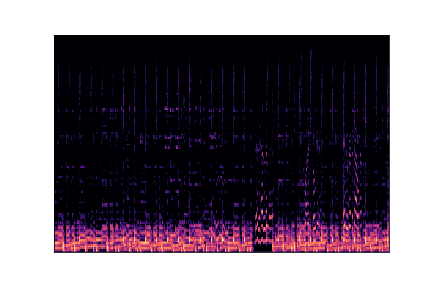

In [ ]:
blues = list(data_dir.glob('blues/*'))
PIL.Image.open(str(blues[0]))

Look Familliar? This looks like what we have when we created a mel spectrum up above. Now lets set the imput and batch sizes. The images are 432X288 pixels.

In [ ]:
batch_size = 32
img_height = 288
img_width = 432

In [ ]:
image_size = (432, 288)
batch_size = 32

train_ds, val_ds = tf.keras.utils.image_dataset_from_directory(
    "/content/Data/images_original",
    validation_split=0.2,
    subset="both",
    seed=10,
    image_size=(img_height, img_width),
    batch_size=batch_size)

class_names = train_ds.class_names
print(class_names)


Found 999 files belonging to 10 classes.
Using 800 files for training.
Using 199 files for validation.
['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock']


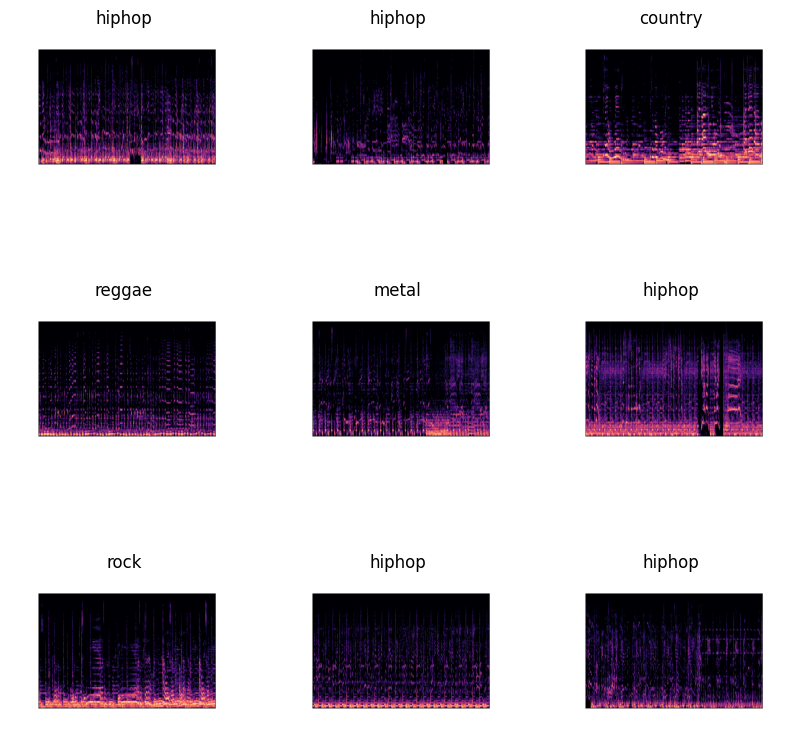

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")


In [ ]:
for image_batch, labels_batch in train_ds:
    print(image_batch.shape)
    print(labels_batch.shape)
    break


(32, 288, 432, 3)
(32,)


### Create CNN for the Images

In [ ]:
num_classes = 10

model1 = tf.keras.Sequential([
  tf.keras.layers.Rescaling(1./255),
  tf.keras.layers.Conv2D(32, 3, activation='relu'),
  tf.keras.layers.MaxPooling2D(),
  tf.keras.layers.Conv2D(64, 3, activation='relu'),
  tf.keras.layers.MaxPooling2D(),
  tf.keras.layers.Conv2D(128, 3, activation='relu'),
  tf.keras.layers.MaxPooling2D(),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(256, activation='relu'),
  tf.keras.layers.Dense(num_classes)
])


In [ ]:
model1.compile(
  optimizer='adam',
  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
  metrics=['accuracy'])

In [ ]:
history2 = model1.fit(
    train_ds,
    validation_data=val_ds,
    epochs=15
)

Epoch 1/15
25/25 [==============================] - 15s 197ms/step - loss: 4.5357 - accuracy: 0.1338 - val_loss: 2.1027 - val_accuracy: 0.2362
Epoch 2/15
25/25 [==============================] - 4s 154ms/step - loss: 1.9374 - accuracy: 0.2788 - val_loss: 1.8566 - val_accuracy: 0.3317
Epoch 3/15
25/25 [==============================] - 5s 189ms/step - loss: 1.5463 - accuracy: 0.4888 - val_loss: 1.5362 - val_accuracy: 0.4724
Epoch 4/15
25/25 [==============================] - 5s 148ms/step - loss: 1.1497 - accuracy: 0.6175 - val_loss: 1.3999 - val_accuracy: 0.4573
Epoch 5/15
25/25 [==============================] - 4s 146ms/step - loss: 0.8544 - accuracy: 0.6950 - val_loss: 1.1935 - val_accuracy: 0.6181
Epoch 6/15
25/25 [==============================] - 5s 198ms/step - loss: 0.5000 - accuracy: 0.8450 - val_loss: 1.5986 - val_accuracy: 0.5075
Epoch 7/15
25/25 [==============================] - 4s 150ms/step - loss: 0.2559 - accuracy: 0.9375 - val_loss: 1.4412 - val_accuracy: 0.5528
Epoch

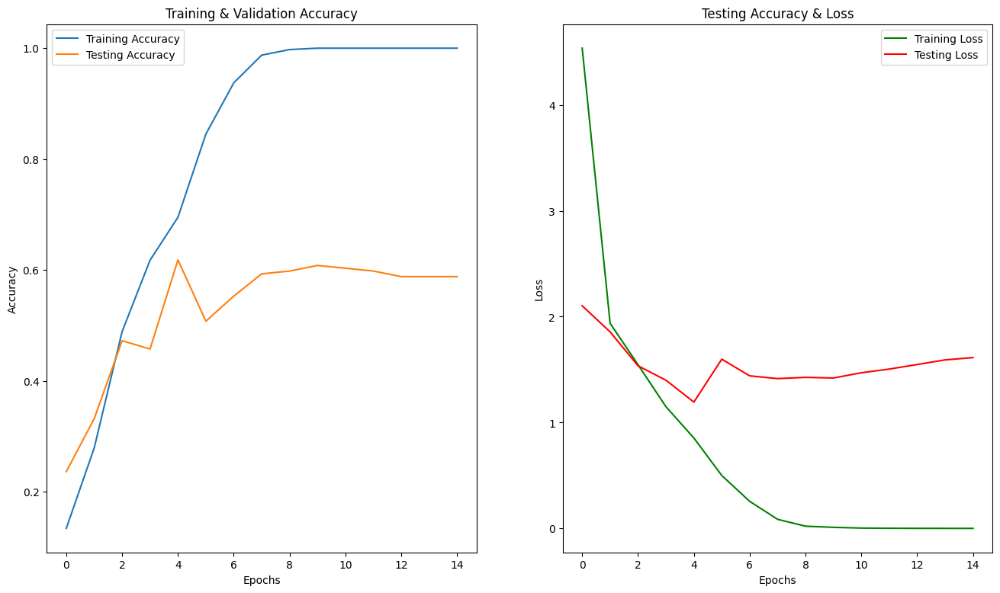

In [ ]:
epochs = [i for i in range(15)]
fig , ax = plt.subplots(1,2)
train_acc = history2.history['accuracy']
train_loss = history2.history['loss']
val_acc = history2.history['val_accuracy']
val_loss = history2.history['val_loss']
fig.set_size_inches(16,9)

ax[0].plot(epochs , train_acc, label = 'Training Accuracy')
ax[0].plot(epochs , val_acc, label = 'Testing Accuracy')
ax[0].set_title('Training & Validation Accuracy')
ax[0].legend()
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")

ax[1].plot(epochs , train_loss , 'g' , label = 'Training Loss')
ax[1].plot(epochs , val_loss , 'r' , label = 'Testing Loss')
ax[1].set_title('Testing Accuracy & Loss')
ax[1].legend()
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Loss")
plt.show()

## Conclusion

Audio analysis and recommender systems are very popular now.  Everyone is trying to get good product recommendations.  Companies like Spotify, Netflix, Amazon, etc., are always looking to improve on their recommender systems and we can see how that can be a very difficult process.  Going through this project has just scrated the surface of audio analysis and the recommender system is very naive. But with good data and a very long time to process we could be able to create a recommender system based off of the genre selection model and our cosine similarity recommender to create a Spotify like system.